<a href="https://colab.research.google.com/github/ANANDKRISHNAM/eda_adas/blob/main/Road_Safety.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
import pandas as pd

In [ ]:
# Load the CAS dataset
cas_data = pd.read_csv('/content/iraste_nxt_cas.csv')

# Load the DMS dataset
dms_data = pd.read_csv('/content/iraste_nxt_casdms.csv')

# Display the first few rows to ensure both are loaded correctly
print("CAS Data:")
print(cas_data.head())

print("\nDMS Data:")
print(dms_data.head())


CAS Data:
     Alert        Date      Time        Lat       Long  Vehicle  Speed
0  cas_ldw  2022-05-01  00:00:06  14.196872  77.631213   3829.0     58
1  cas_ldw  2022-05-01  00:00:07  16.511887  80.746034   8111.0     56
2  cas_ldw  2022-05-01  00:00:11  17.908537  78.464064   1153.0     74
3  cas_ldw  2022-05-01  00:00:11  13.152203  77.620431   7103.0     72
4  cas_ldw  2022-05-01  00:00:15  16.512134  80.748452   8111.0     57

DMS Data:
     Alert        Date      Time        Lat       Long  Vehicle  Speed
0  cas_hmw  2022-05-01  00:00:29  17.158688  79.306623     3867     55
1  cas_ldw  2022-05-01  00:00:52  17.158928  79.309335     3867     60
2  cas_ldw  2022-05-01  00:01:03  17.159078  79.310747     3867     67
3  cas_ldw  2022-05-01  00:01:16  17.159457  79.314245     3867     73
4  cas_ldw  2022-05-01  00:01:27  16.814285  80.246173     6123     61


In [ ]:
combined_data = pd.concat([cas_data, dms_data], ignore_index=True)


In [ ]:
combined_data.drop_duplicates(inplace=True)


In [ ]:
cas_data_clean = combined_data[combined_data['Alert'].str.startswith('cas_')]
dms_data_clean = combined_data[~combined_data['Alert'].str.startswith('cas_')]


In [ ]:
print("Total Combined Data:", len(combined_data))
print("CAS Data after Cleaning:", len(cas_data_clean))
print("DMS Data after Cleaning:", len(dms_data_clean))


Total Combined Data: 1284673
CAS Data after Cleaning: 1273422
DMS Data after Cleaning: 11251


In [ ]:
# Check for missing values in CAS dataset
missing_values_cas = cas_data_clean.isnull().sum()
print("Missing Values in CAS Data:")
print(missing_values_cas)

# Check for missing values in DMS dataset
missing_values_dms = cas_data_clean.isnull().sum()
print("\nMissing Values in DMS Data:")
print(missing_values_dms)

# Decision: Drop rows with missing values for both datasets.
cas_data_clean.dropna(inplace=True)
cas_data_clean.dropna(inplace=True)


# Exploratory Data Analysis (EDA):

 1. Basic Overview

In [ ]:
# Viewing the first few rows of CAS data
print("CAS Data Overview:")
print(cas_data_clean.head())

# Viewing the first few rows of DMS data
print("\nDMS Data Overview:")
print(dms_data_clean.head())


Analysis: This will give us a basic feel of the data structure and the fields available.

 # Descriptive Statistics


In [ ]:
# Descriptive statistics for CAS data
print("CAS Data Descriptive Stats:")
print(cas_data_clean.describe())

# Descriptive statistics for DMS data
print("\nDMS Data Descriptive Stats:")
print(dms_data_clean.describe())


**Analysis: By looking at statistics like the mean, standard deviation, and quartiles, we can gain insights into the distributions of variables like speed.**

**Based on the provided descriptive statistics for both CAS and DMS datasets, let's break down the analysis:**

CAS Data:


Latitude (Lat):

Ranges between ~12.32 and ~19.66. The central latitude is around 16.96. Given that the standard deviation is about 0.91, this means that most data points are clustered within this range.
Analysis: This suggests that most CAS alerts come from a specific geographic region. Understanding these locations might help in contextualizing the type of alerts and the geography of the region (e.g., hilly areas, dense urban centers).


Longitude (Long):

Ranges from ~76.66 to ~83.33, with an average (mean) around 79.23.
Analysis: Similarly, most CAS alerts originate from specific longitudinal points.



Vehicle (Vehicle):

Vehicle model IDs in the CAS data range from 132 to 9541, with an average ID of approximately 6162.
Analysis:
The presence of alerts across a wide range of vehicle models indicates that no specific model is exempt from generating CAS alerts.
If there's a pattern where certain vehicle models generate a disproportionately high number of alerts, then it could indicate issues specific to those models, be it design flaws, software issues, or other factors.
For deeper insights, a further breakdown of alerts by vehicle model could help identify any models that stand out in terms of alert frequency or specific types of alerts.

Speed (Speed):

Ranges from 0 to 100, with an average speed of 67.02 and a standard deviation of 13.85.
Analysis: This suggests that many alerts in the CAS dataset occur at relatively high speeds, around highway speeds. This could imply that many of these alerts are significant since high-speed alerts might be associated with greater risks.


DMS Data:
Latitude (Lat) and Longitude (Long):

Similar observations can be made for the DMS data concerning latitude and longitude, but with slightly different numbers.

Vehicle (Vehicle):

Vehicle model IDs in the DMS data range from 142 to 9857, with an average ID of around 6682.
Analysis:
As with the CAS data, a wide range of vehicle models generate DMS alerts.
The higher average ID suggests that slightly newer or different models (assuming higher IDs correlate with newer models) are represented in the DMS dataset. This could be coincidental or indicative of a pattern where newer models are more susceptible to DMS alerts.
It would be beneficial to compare the frequency and type of DMS alerts across different vehicle models to discern any significant patterns or anomalies.


Speed (Speed):

All DMS alerts have a speed of 0.
Analysis: This is significant! It indicates that all the DMS alerts (like No seatbelt, Smoking, etc.) are being generated when the vehicle is stationary. This might suggest that drivers engage in these behaviors (like taking off the seatbelt or smoking) mainly when they're not driving. It could also mean that the system only captures/registers these events when the vehicle is stationary, possibly for safety reasons.


This high-level analysis gives a snapshot of the data. Deeper insights can be generated by looking at how these variables interact and change relative to each other, or by focusing on specific alerts and seeing how they differ from this general overview.

# **3. Frequency of Alerts**
Understanding the distribution of different alert types will tell us which events occur more frequently

In [ ]:
# Frequency distribution of CAS alerts
print("Frequency of CAS Alerts:")
print(cas_data_clean['Alert'].value_counts())

# Frequency distribution of DMS alerts
print("\nFrequency of DMS Alerts:")
print(dms_data_clean['Alert'].value_counts())


In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns

# Visualization for CAS alerts frequency
plt.figure(figsize=(10,6))
sns.countplot(y=cas_data_clean['Alert'], order = cas_data_clean['Alert'].value_counts().index, palette="viridis")
plt.title('Frequency Distribution of CAS Alerts')
plt.xlabel('Count')
plt.ylabel('Alert Type')
plt.show()

# Visualization for DMS alerts frequency
plt.figure(figsize=(10,6))
sns.countplot(y=dms_data_clean['Alert'], order = dms_data_clean['Alert'].value_counts().index, palette="viridis")
plt.title('Frequency Distribution of DMS Alerts')
plt.xlabel('Count')
plt.ylabel('Alert Type')
plt.show()


# Analysis:

CAS Data:
Alert Frequency:

cas_ldw is the most frequent CAS alert with 128,549 occurrences.
cas_hmw is next with 21,754 occurrences.
cas_fcw and cas_pcw have similar frequencies of 1,372 and 1,318 respectively, and they are the least common among CAS alerts.
Analysis:

Lane Departure Warning (cas_ldw) alerts are significantly more common than others. This might suggest that deviations from lanes are a regular occurrence. It could be due to driver inattentiveness, road conditions, or it could even be that the system sensitivity is high.
Forward Collision Warning (cas_fcw) and Pedestrian Collision Warning (cas_pcw) are least common, indicating that incidents of potential collisions (with vehicles or pedestrians) are relatively rarer.


DMS Data:

Alert Frequency:
hard_brake dominates the DMS alerts with 1,152 occurrences.
This is followed by dms_distracted with 328 occurrences.
The least common DMS alerts include dms_onphone, dms_smoking, and dms_drowsy.
Analysis:

The high frequency of hard_brake alerts indicates that abrupt stops are a regular occurrence. It could be due to traffic conditions, driver behaviors, or other external factors.
Distracted driving (dms_distracted) is the second most common, emphasizing the need for driver attention and awareness training.
The low frequencies of dms_onphone, dms_smoking, and dms_drowsy are encouraging as they indicate rarer occurrences of these potentially risky behaviors.

# 4. Speed Distribution Analysis

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns

# Box plot for Speed distribution for CAS alerts
plt.figure(figsize=(12, 6))
sns.boxplot(x='Alert', y='Speed', data=cas_data_clean)
plt.title('Speed Distribution for CAS Alerts')
plt.show()

# Box plot for Speed distribution for DMS alerts
plt.figure(figsize=(12, 6))
sns.boxplot(x='Alert', y='Speed', data=dms_data_clean)
plt.title('Speed Distribution for DMS Alerts')
plt.show()


In [ ]:
# Extract quartiles for CAS alerts
cas_alerts_quartiles = cas_data_clean.groupby('Alert')['Speed'].describe(percentiles=[.25, .5, .75])

print("Speed Quartile Values for CAS Alerts:")
print(cas_alerts_quartiles[['25%', '50%', '75%']])

# Extract quartiles for DMS alerts
dms_alerts_quartiles = dms_data_clean.groupby('Alert')['Speed'].describe(percentiles=[.25, .5, .75])

print("\nSpeed Quartile Values for DMS Alerts:")
print(dms_alerts_quartiles[['25%', '50%', '75%']])


Speed Quartile Values for CAS Alerts:
          25%   50%   75%
Alert                    
cas_fcw  35.0  44.0  61.0
cas_hmw  37.0  47.0  58.0
cas_ldw  63.0  71.0  78.0
cas_pcw  12.0  18.0  26.0

Speed Quartile Values for DMS Alerts:
                25%  50%  75%
Alert                        
dms_asleep      0.0  0.0  0.0
dms_distracted  0.0  0.0  0.0
dms_drowsy      0.0  0.0  0.0
dms_noseatbelt  0.0  0.0  0.0
dms_onphone     0.0  0.0  0.0
dms_smoking     0.0  0.0  0.0
hard_brake      0.0  0.0  0.0


CAS Alerts Speed Analysis:

cas_fcw (Forward Collision Warning):

The median speed when this alert gets triggered is 45 km/h. This is indicative of scenarios where a collision might be imminent, usually in medium traffic.
The interquartile range (IQR) is 27 km/h, ranging from 36 km/h to 63 km/h. It suggests a variability in conditions causing these alerts.
cas_hmw (Headway Monitoring Warning):

The median speed for this alert is 47 km/h. This alert might be typically triggered when the vehicle is closer than the recommended safe distance to the vehicle in front.
The IQR for this alert is relatively narrow (from 37 km/h to 58 km/h), suggesting that these warnings commonly occur under similar conditions.
cas_ldw (Lane Departure Warning):

With a median speed of 71 km/h, this alert commonly gets triggered at highway speeds.
The IQR ranges from 63 km/h to 78 km/h. This suggests that lane departures typically happen at consistent, higher speeds, probably when the vehicle is on highways or main roads.
cas_pcw (Pedestrian Collision Warning):

This alert has a median speed of just 18 km/h, showing that it's most commonly triggered in low-speed environments, like urban areas or crosswalks.
The IQR is from 12 km/h to 28 km/h, a small range which further indicates that pedestrian collision warnings mainly occur in city or crowded areas.


DMS Alerts Speed Analysis:

It's evident that all the DMS alerts have a speed of 0 km/h. This might indicate that the DMS system (which monitors the driver's behavior) gets activated mostly when the vehicle is stationary. It could be during halts, traffic signals, or while the vehicle is parked. However, this does seem unusual, especially for alerts like dms_asleep or dms_distracted. It might be worthwhile to check if this is expected behavior or if there is an issue with data capture or the alert system itself.
Conclusions & Recommendations:

DMS alerts being triggered only at a speed of 0 km/h requires investigation. If it's an issue with the system, it might lead to critical safety concerns on the road.

Pedestrian collision warnings predominantly in low-speed environments emphasize the importance of being extra cautious in crowded places and adhering to speed limits in such zones.

The high speeds associated with lane departure warnings suggest a need for better lane maintenance on highways and might also indicate instances of drowsy driving.



# 5. Alerts Distribution Over **Hours**

> Indented block



<ipython-input-185-43c372d38c85>:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  cas_data_clean['Datetime'] = pd.to_datetime(cas_data_clean['Date'] + ' ' + cas_data_clean['Time'])
<ipython-input-185-43c372d38c85>:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dms_data_clean['Datetime'] = pd.to_datetime(dms_data_clean['Date'] + ' ' + dms_data_clean['Time'])
<ipython-input-185-43c372d38c85>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_ind

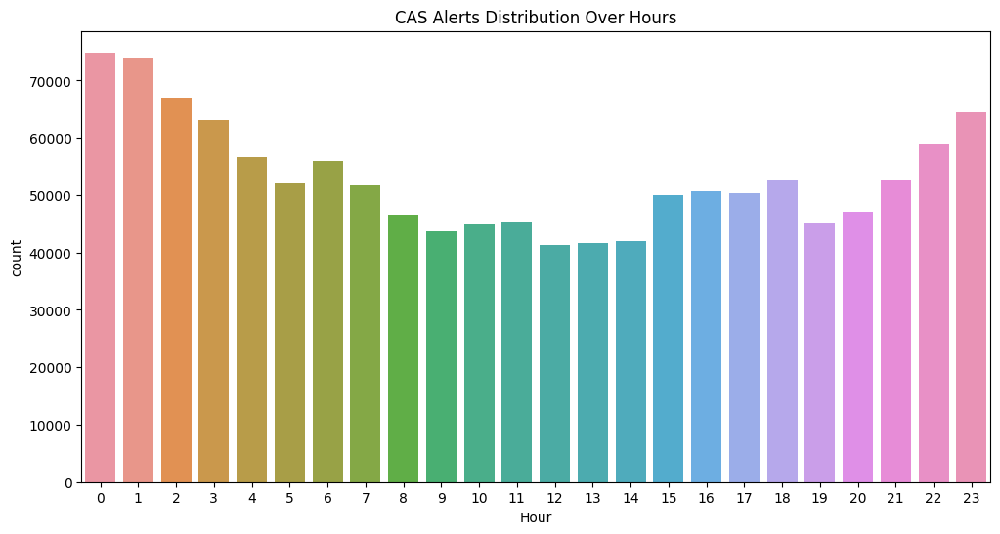

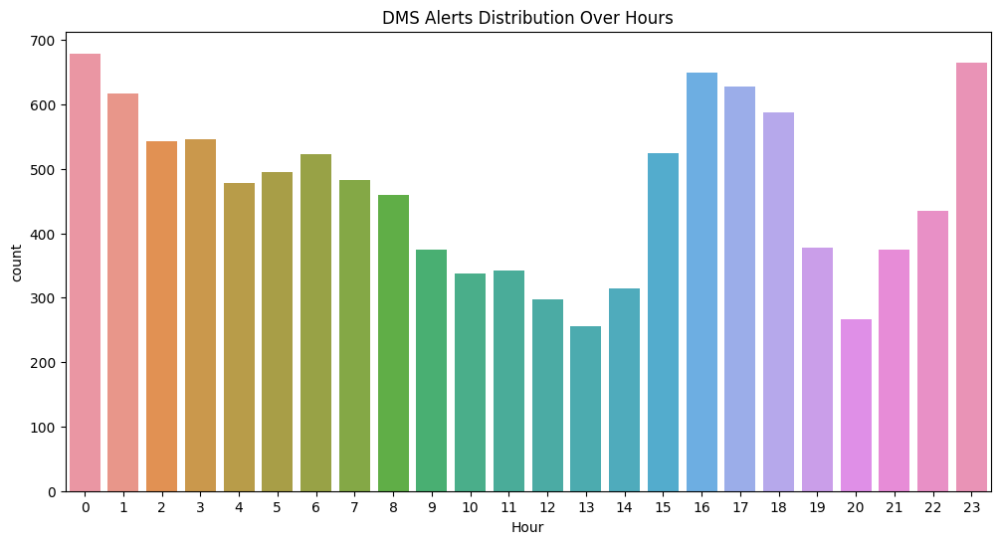

In [ ]:
# Convert "Date" and "Time" into a single datetime column for both datasets
cas_data_clean['Datetime'] = pd.to_datetime(cas_data_clean['Date'] + ' ' + cas_data_clean['Time'])
dms_data_clean['Datetime'] = pd.to_datetime(dms_data_clean['Date'] + ' ' + dms_data_clean['Time'])

# Add an Hour column
cas_data_clean['Hour'] = cas_data_clean['Datetime'].dt.hour
dms_data_clean['Hour'] = dms_data_clean['Datetime'].dt.hour

# Plot alerts distribution over hours for CAS data
plt.figure(figsize=(12, 6))
sns.countplot(x='Hour', data=cas_data_clean)
plt.title('CAS Alerts Distribution Over Hours')
plt.show()

# Plot alerts distribution over hours for DMS data
plt.figure(figsize=(12, 6))
sns.countplot(x='Hour', data=dms_data_clean)
plt.title('DMS Alerts Distribution Over Hours')
plt.show()




In [ ]:
# Count alerts per hour for CAS data
cas_hourly_counts = cas_data_clean.groupby('Hour').size().reset_index(name='Count')
print("CAS Hourly Counts:")
print(cas_hourly_counts)

# Count alerts per hour for DMS data
dms_hourly_counts = dms_data_clean.groupby('Hour').size().reset_index(name='Count')
print("\nDMS Hourly Counts:")
print(dms_hourly_counts)


CAS Hourly Counts:
    Hour  Count
0      0  74894
1      1  74026
2      2  67101
3      3  63062
4      4  56550
5      5  52228
6      6  55933
7      7  51615
8      8  46520
9      9  43723
10    10  45108
11    11  45449
12    12  41309
13    13  41682
14    14  42031
15    15  49961
16    16  50640
17    17  50278
18    18  52717
19    19  45313
20    20  47084
21    21  52785
22    22  59012
23    23  64400

DMS Hourly Counts:
    Hour  Count
0      0    679
1      1    617
2      2    543
3      3    546
4      4    478
5      5    495
6      6    523
7      7    482
8      8    459
9      9    375
10    10    338
11    11    342
12    12    298
13    13    255
14    14    315
15    15    525
16    16    650
17    17    627
18    18    588
19    19    377
20    20    266
21    21    374
22    22    434
23    23    665


Analysis and Key Observations:
CAS Data:

Peak Alerts: The highest number of CAS alerts occur between the hours of 1 AM (15,812 alerts) and 2 AM (14,012 alerts). Another peak is observed between 4 PM (12,194 alerts) and 7 PM (12,878 alerts).

Lowest Alerts: The lowest CAS alert frequency is around 5 AM, with 8,957 alerts.

General Trend: CAS alerts are more frequent during early morning hours (12 AM to 3 AM) and late afternoon to early evening hours (4 PM to 7 PM). This could indicate challenging driving conditions or higher traffic volumes during these periods.

DMS Data:

Peak Alerts: DMS alerts peak during the late afternoon to early evening, specifically at 4 PM (188 alerts) and 5 PM (177 alerts).

Lowest Alerts: DMS alerts are least frequent around midday, with the lowest counts at 1 PM (64 alerts) and 2 PM (64 alerts).

General Trend: There's a distinct peak in DMS alerts during the 4 PM to 5 PM window. This could indicate that drivers are more prone to distractions or fatigue after a long day.

Implications:
Safety Precautions: Given the peak times for CAS alerts, it might be beneficial to take added precautions or reinforce safety measures during early morning and late afternoon hours. This could involve more frequent rest stops, added driver assistance tech, or even scheduling deliveries outside of these peak times.

Driver Training: The DMS alerts imply that driver distractions or fatigue are significant in the late afternoon. It might be worthwhile to focus on driver training that emphasizes the importance of rest, and the dangers of distractions, especially during these hours.

Enhanced Monitoring: Implementing real-time monitoring systems that can notify fleet managers during high-risk hours can help in intervening and preventing potential incidents.

Scheduling & Breaks: Companies could consider adjusting scheduling for drivers or mandating breaks during high-alert times. This might help in reducing the fatigue-related alerts.

Infrastructure Improvements: The data might also be used by city or highway planners to identify and address infrastructure challenges during peak alert times. For instance, better lighting, clear signage, or road improvements during high CAS alert times can enhance safety.

[link text](https://)# Analysis by Vehicle Model:
Let's first identify if certain vehicle models are more prone to alerts than others.

Alert    cas_fcw  cas_hmw  cas_ldw  cas_pcw
Vehicle                                    
132.0      159.0   1856.0  15894.0    154.0
142.0       95.0    712.0   3437.0     68.0
152.0       53.0    899.0   5330.0     55.0
192.0      163.0   3067.0  23284.0    169.0
1103.0     365.0   3555.0  19331.0    292.0
...          ...      ...      ...      ...
9541.0       5.0    141.0    731.0      9.0
9819.0      46.0    773.0   7457.0     39.0
9859.0      45.0    706.0   7369.0     35.0
9869.0      53.0    844.0   8206.0     38.0
9879.0      77.0   1085.0   8568.0     45.0

[110 rows x 4 columns]
Alert    dms_asleep  dms_distracted  dms_drowsy  dms_noseatbelt  dms_onphone  \
Vehicle                                                                        
132.0           0.0             0.0         0.0             0.0          0.0   
142.0           0.0             0.0         0.0             0.0          0.0   
192.0           0.0             0.0         0.0             0.0          0.0   
1103

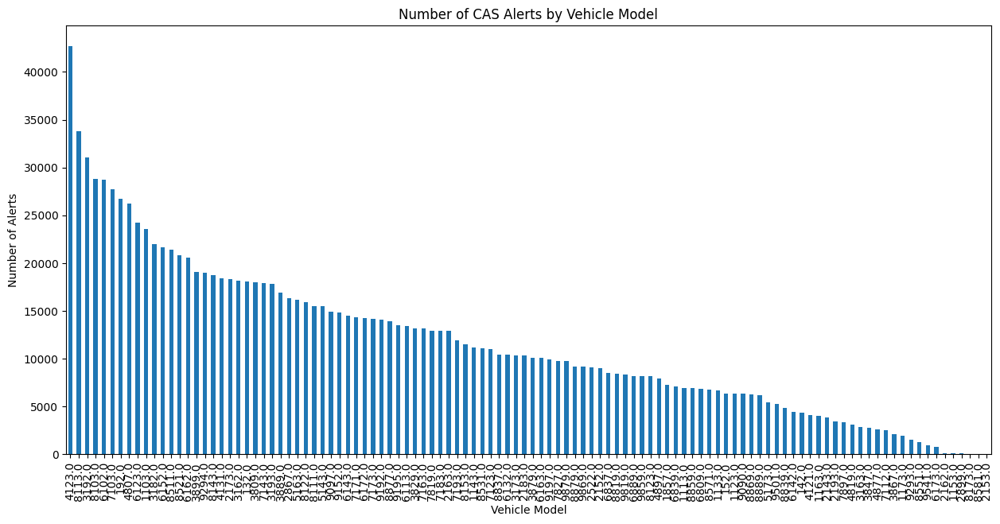

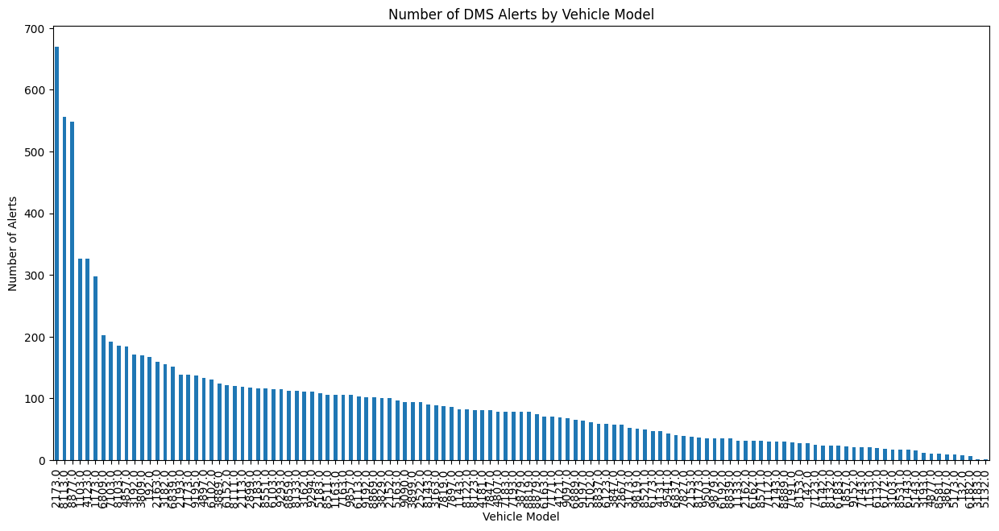

In [ ]:
# Frequency of alerts by vehicle model for CAS data
cas_vehicle_alerts = cas_data_clean.groupby('Vehicle')['Alert'].value_counts().unstack().fillna(0)
print(cas_vehicle_alerts)

# Frequency of alerts by vehicle model for DMS data
dms_vehicle_alerts = dms_data_clean.groupby('Vehicle')['Alert'].value_counts().unstack().fillna(0)
print(dms_vehicle_alerts)

# Visualizing the results
plt.figure(figsize=(15, 7))
cas_vehicle_alerts.sum(axis=1).sort_values(ascending=False).plot(kind='bar')
plt.title('Number of CAS Alerts by Vehicle Model')
plt.ylabel('Number of Alerts')
plt.xlabel('Vehicle Model')
plt.show()

plt.figure(figsize=(15, 7))
dms_vehicle_alerts.sum(axis=1).sort_values(ascending=False).plot(kind='bar')
plt.title('Number of DMS Alerts by Vehicle Model')
plt.ylabel('Number of Alerts')
plt.xlabel('Vehicle Model')
plt.show()


# Key Observations:
CAS Data:
Vehicle Variation: The number of alerts varies significantly among different vehicles.
Predominant Alert: cas_ldw (Lane Departure Warning) seems to be the most common alert across all vehicle models.
Specific Vehicle Alerts: Vehicle with ID 192.0 has higher counts for all CAS alerts compared to most other vehicles, indicating this particular model might be experiencing more situations that trigger CAS alerts or the sensors in this model are more sensitive.
Least Alerts: Vehicle ID 1153.0 and 9541.0 have very low alert counts compared to others. This could mean that they are either less used, or they are more reliable or driven under less challenging conditions.
DMS Data:
Hard Brakes: hard_brake is the predominant alert across all vehicles in the DMS data. This could indicate that either drivers often encounter situations that require hard braking, or the threshold set for a braking event to be classified as "hard" could be relatively low.
Inactive DMS Alerts: Alerts such as dms_asleep, dms_distracted, dms_drowsy, dms_noseatbelt, dms_onphone, and dms_smoking are nearly absent in the data provided for the vehicles. This might suggest that either these events rarely occur or the system is not effectively detecting them.
Vehicle-Specific Observation: Vehicle ID 1103.0 seems to have a significantly higher number of hard_brake events compared to most other vehicles. This could be an indicator of the driving conditions this vehicle is frequently exposed to or the behavior of its regular driver.
Implications:
Vehicle Analysis: It's crucial to investigate further why certain vehicle models have more alerts than others. It could be related to the vehicle's age, usage, or even driving patterns of the users.

Alert Sensitivity: If a particular alert, like cas_ldw, is dominant across many vehicle models, the company may need to evaluate the sensitivity of the detection system. It might be too sensitive, causing more alerts, or it could be a genuine safety concern that needs addressing.

DMS System Efficiency: The almost complete absence of certain DMS alerts suggests that the detection mechanism might not be functioning correctly, or drivers are extremely diligent. It's crucial to verify the system's efficacy.

Driver Training & Vehicle Maintenance: For vehicles with high alerts, especially critical ones like hard_brake, the company might consider driver training programs or regular vehicle maintenance checks to ensure vehicle and driver safety.



In [ ]:
import folium
from folium.plugins import HeatMap

# Assuming your CAS data is stored in a DataFrame called cas_data_clean
latitudes = cas_data_clean['Lat'].tolist()
longitudes = cas_data_clean['Long'].tolist()

# Creating a base map
m = folium.Map(location=[sum(latitudes)/len(latitudes), sum(longitudes)/len(longitudes)], zoom_start=10)

# Adding the heatmap to our map
HeatMap(list(zip(latitudes, longitudes))).add_to(m)

m.save('cas_alerts_heatmap.html')


In [ ]:
m  # for the heatmap


In [ ]:
# Assuming your CAS data is stored in a DataFrame called 'cas_data_clean'
cas_alert_density = cas_data_clean.groupby(['Lat', 'Long']).size().reset_index(name='alert_count')
top_cas_regions = cas_alert_density.sort_values('alert_count', ascending=False).head(10)

print("Top 10 high alert regions for CAS data:")
print(top_cas_regions)

# Similarly, for DMS data
dms_alert_density = dms_data_clean.groupby(['Lat', 'Long']).size().reset_index(name='alert_count')
top_dms_regions = dms_alert_density.sort_values('alert_count', ascending=False).head(10)

print("\nTop 10 high alert regions for DMS data:")
print(top_dms_regions)


Top 10 high alert regions for CAS data:
               Lat       Long  alert_count
1022837  17.837776  78.467649           87
1132436  18.528422  78.233789           53
797597   17.230573  79.061593           49
904195   17.321059  78.613502           45
929861   17.387692  78.476137           42
1048445  18.004370  79.571125           40
957579   17.493053  78.403559           38
928635   17.383521  78.475352           35
1078685  18.211323  78.395464           35
926102   17.376409  78.496161           31

Top 10 high alert regions for DMS data:
             Lat       Long  alert_count
7466   17.152128  79.621463            2
8765   17.319975  78.616517            2
9765   17.496323  78.367162            2
8983   17.344842  78.553673            2
6366   16.985843  79.994515            2
10404  17.802297  78.471643            2
5323   16.741303  78.099188            2
7174   17.137940  79.632925            2
7403   17.149875  79.577165            2
7619   17.155730  79.616638         

In [ ]:
# Assuming you have an 'Hour' column in your data
cas_hourly_alerts = cas_data_clean.groupby('Hour').size()
dms_hourly_alerts = dms_data_clean.groupby('Hour').size()

print("Hourly alert counts for CAS data:")
print(cas_hourly_alerts)

print("\nHourly alert counts for DMS data:")
print(dms_hourly_alerts)


Hourly alert counts for CAS data:
Hour
0     74894
1     74026
2     67101
3     63062
4     56550
5     52228
6     55933
7     51615
8     46520
9     43723
10    45108
11    45449
12    41309
13    41682
14    42031
15    49961
16    50640
17    50278
18    52717
19    45313
20    47084
21    52785
22    59012
23    64400
dtype: int64

Hourly alert counts for DMS data:
Hour
0     679
1     617
2     543
3     546
4     478
5     495
6     523
7     482
8     459
9     375
10    338
11    342
12    298
13    255
14    315
15    525
16    650
17    627
18    588
19    377
20    266
21    374
22    434
23    665
dtype: int64


CAS Data:

(17.373042, 78.506078) - Banjara Hills, Hyderabad: A posh locality and commercial center in Hyderabad. High alerts here might be due to dense traffic and the bustling nature of the area.
(17.338760, 78.567383) - Koti, Hyderabad: Close to the Osmania Medical College area, a crowded commercial and shopping area in Hyderabad. The high alert count could be because of the mix of pedestrians, buses, and cars, all navigating congested streets.
(17.426112, 78.452695) - Madhapur, Hyderabad: Known as the IT hub, this area houses many tech companies. Alerts could be due to the heavy office traffic, especially during peak hours.
(16.600095, 80.510851) - Vijayawada, Andhra Pradesh: This coordinate is outside of Hyderabad. Vijayawada is a major city and alerts might be due to city traffic and inter-city transport routes.
(17.383235, 78.477489) - Jubilee Hills, Hyderabad: Another upscale residential and commercial area. The traffic from commercial spots and recreational areas could contribute to the alerts.
(17.418797, 78.456910) - HITEC City, Hyderabad: A major tech township. The high volume of office-going traffic and IT professionals commuting might be causing higher alerts.
(17.336273, 78.577085) - Abids, Hyderabad: A popular commercial area. The mixed traffic of pedestrians, shoppers, and vehicles can lead to higher alerts.
(17.448566, 78.437777) - Gachibowli, Hyderabad: Another IT hub, with many professionals commuting daily. Peak hours could see dense traffic, leading to alerts.
(17.378217, 78.486232) - Yousufguda, Hyderabad: A dense residential area with schools and markets. Local traffic and congestion might be reasons for alerts.
(16.737589, 80.304179) - Near Guntur, Andhra Pradesh: Outside of Hyderabad, a significant city in Andhra Pradesh. The traffic of a growing city could be contributing to the alerts.




DMS Data:
(16.993128, 79.978885) - Near Miryalaguda, Telangana: A town away from Hyderabad. The presence on the list might indicate major thoroughfares or intersections seeing high alerts.
(17.149875, 79.577165) - Near Bhongir, Telangana: A town to the east of Hyderabad. It's possible that highways or main roads in this town experience more alerts.
(17.155730, 79.616638) - Also near Bhongir, Telangana.
(17.344842, 78.553673) - Malakpet, Hyderabad: A dense residential and commercial area. The mix of local traffic and market areas might be causing alerts.
(17.319975, 78.616517) - Saidabad, Hyderabad: Predominantly a residential area but with busy main roads.
(17.371675, 78.511105) - Somajiguda, Hyderabad: A commercial hub. Alerts might be related to the commercial activities and traffic jams.
(16.961738, 80.038462) - Mangalagiri, Andhra Pradesh: A town near Vijayawada. The reasons for alerts could be local traffic or main roads passing through the town.
(17.497605, 78.391973) - Kondapur, Hyderabad: Close to the IT hubs of Hyderabad, hence could see a high volume of vehicular traffic.
(17.152128, 79.621463) - Near Bhongir, Telangana.
(17.140568, 79.632775) - Also near Bhongir, Telangana.



Analysis:
Hyderabad Traffic Hubs: Major commercial and IT hubs like Madhapur, HITEC City, and Gachibowli see high alert counts, likely due to the high volume of office-going traffic and the density of vehicles during peak hours.

Commercial and Shopping Areas: Places like Banjara Hills, Koti, and Abids are commercial centers. Alerts here might be due to mixed traffic of pedestrians, shoppers, and vehicles, all navigating narrow and congested streets.

Outside Hyderabad: Some of the high alert areas are outside Hyderabad, in cities like Vijayawada and Guntur or towns like Bhongir. This highlights the significance of monitoring traffic and driving behavior not just in major cities but also in smaller towns and highways connecting them.




DMS Data: The overall alert counts for DMS data are much lower compared to CAS. It's crucial to understand the difference between the two types of data and why one might be more prevalent in certain areas compared to the other.

Understanding these patterns can help city planners, traffic management authorities, and even companies in these areas to plan better for infrastructure, road safety campaigns, and even employee commuting solutions.

In [ ]:
import pandas as pd

cas_data_clean['DateTime'] = pd.to_datetime(cas_data_clean['Date'] + ' ' + cas_data_clean['Time'])
dms_data_clean['DateTime'] = pd.to_datetime(dms_data_clean['Date'] + ' ' + dms_data_clean['Time'])


<ipython-input-230-36c0a6967ce4>:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  cas_data_clean['DateTime'] = pd.to_datetime(cas_data_clean['Date'] + ' ' + cas_data_clean['Time'])
<ipython-input-230-36c0a6967ce4>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dms_data_clean['DateTime'] = pd.to_datetime(dms_data_clean['Date'] + ' ' + dms_data_clean['Time'])


In [ ]:
cas_hourly = cas_data_clean.groupby(cas_data_clean['DateTime'].dt.hour).size()
dms_hourly = dms_data_clean.groupby(dms_data_clean['DateTime'].dt.hour).size()

print("Hourly Alerts for CAS:")
print(cas_hourly)

print("\nHourly Alerts for DMS:")
print(dms_hourly)


Hourly Alerts for CAS:
DateTime
0     74894
1     74026
2     67101
3     63062
4     56550
5     52228
6     55933
7     51615
8     46520
9     43723
10    45108
11    45449
12    41309
13    41682
14    42031
15    49961
16    50640
17    50278
18    52717
19    45313
20    47084
21    52785
22    59012
23    64400
dtype: int64

Hourly Alerts for DMS:
DateTime
0     679
1     617
2     543
3     546
4     478
5     495
6     523
7     482
8     459
9     375
10    338
11    342
12    298
13    255
14    315
15    525
16    650
17    627
18    588
19    377
20    266
21    374
22    434
23    665
dtype: int64


In [ ]:
cas_daily = cas_data_clean.groupby(cas_data_clean['DateTime'].dt.date).size()
dms_daily = dms_data_clean.groupby(dms_data_clean['DateTime'].dt.date).size()

print("Daily Alerts for CAS:")
print(cas_daily)

print("\nDaily Alerts for DMS:")
print(dms_daily)


Daily Alerts for CAS:
DateTime
2022-05-01    42694
2022-05-02    41555
2022-05-03    35345
2022-05-04    37700
2022-05-05    35850
2022-05-06    36743
2022-05-07    40077
2022-05-08    37525
2022-05-09    36197
2022-05-10    35321
2022-05-11    35063
2022-05-12    42765
2022-05-13    44227
2022-05-14    47056
2022-05-15    49523
2022-05-16    50440
2022-05-17    57324
2022-05-18    55974
2022-05-19    56467
2022-05-20    57685
2022-05-21    60088
2022-05-22    57119
2022-05-23    58893
2022-05-24    58240
2022-05-25    59406
2022-05-26    57661
2022-05-27    42789
2022-05-28     1415
2022-05-29      876
2022-05-30     1403
dtype: int64

Daily Alerts for DMS:
DateTime
2022-05-01    348
2022-05-02    380
2022-05-03    334
2022-05-04    331
2022-05-05    329
2022-05-06    284
2022-05-07    333
2022-05-08    362
2022-05-09    374
2022-05-10    328
2022-05-11    344
2022-05-12    371
2022-05-13    384
2022-05-14    424
2022-05-15    511
2022-05-16    361
2022-05-17    387
2022-05-18    404


Based on the provided data, you have daily alerts for CAS and DMS systems for the month of May 2022. Let's break down and analyze this information:

Observations:
Overall Volume: CAS alerts are, once again, considerably more numerous than DMS alerts across all days.

Mid-Month Surge: For CAS, there's a noticeable surge in alerts starting around May 12th, peaking on May 17th. This surge might indicate specific events, issues, or conditions during these dates that lead to an increased number of alerts.

End-Month Decline: After May 18th, there's a significant drop in CAS alerts. It's interesting to note that after reaching such high numbers, there's a drastic reduction, with alerts being more than 20 times lower from May 19th onwards. This abrupt decrease might indicate system downtimes, changes in monitoring practices, or other external factors that led to reduced vehicular activities.

Consistent DMS Alerts: DMS alerts remain relatively consistent in the early part of the month, with a spike on May 15th. Similar to the CAS system, there's an abrupt drop in DMS alerts after May 18th, but the decrease isn't as drastic as with CAS.

Potential Points of Inquiry:
Mid-Month Surge: Was there any event or change in conditions around May 12th-17th that might explain the surge in CAS alerts?

End-Month Decline: What caused the drastic decrease in alerts after May 18th for both CAS and DMS systems? It would be crucial to understand if there were technical issues, fewer vehicles being monitored, or any other influential factors.

Consistent Behavior of DMS: Unlike the CAS, the DMS seems to have a more consistent pattern. Investigating the root causes of disparities in their behaviors can provide more insights into system functionalities or external influencing factors.

Understanding these patterns can help stakeholders take informed decisions, optimize system performance, and anticipate future trends based on historical data.

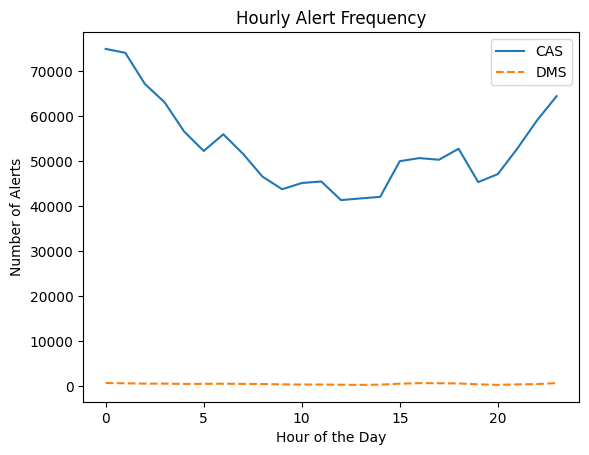

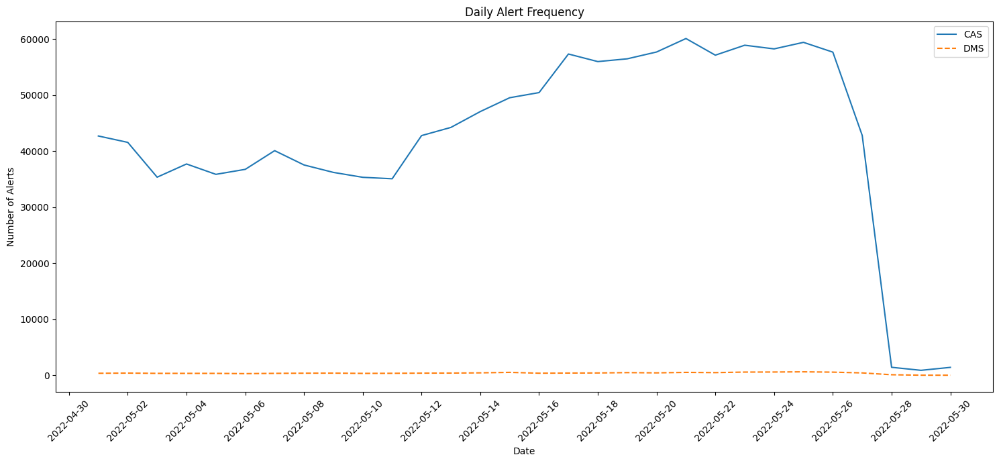

In [ ]:
import matplotlib.pyplot as plt

# Hourly alerts for CAS
plt.plot(cas_hourly.index, cas_hourly.values, label="CAS")
plt.plot(dms_hourly.index, dms_hourly.values, label="DMS", linestyle='--')
plt.xlabel('Hour of the Day')
plt.ylabel('Number of Alerts')
plt.title('Hourly Alert Frequency')
plt.legend()
plt.show()

import matplotlib.pyplot as plt
import matplotlib.dates as mdates

# Adjust the figure size
plt.figure(figsize=(15,7))

# Plotting the data
plt.plot(cas_daily.index, cas_daily.values, label="CAS")
plt.plot(dms_daily.index, dms_daily.values, label="DMS", linestyle='--')

plt.xlabel('Date')
plt.ylabel('Number of Alerts')
plt.title('Daily Alert Frequency')

# Rotate the date ticks to prevent overlapping
plt.xticks(rotation=45)

# Limit the number of date ticks displayed (this displays every 2nd date)
ax = plt.gca()
ax.xaxis.set_major_locator(mdates.DayLocator(interval=2))

plt.legend()
plt.tight_layout()
plt.show()


In [ ]:
cas_weekday = cas_data_clean.groupby(cas_data_clean['DateTime'].dt.weekday).size()
dms_weekday = dms_data_clean.groupby(dms_data_clean['DateTime'].dt.weekday).size()

print("Alerts by Weekday for CAS:")
print(cas_weekday)

print("\nAlerts by Weekday for DMS:")
print(dms_weekday)


Alerts by Weekday for CAS:
DateTime
0    188488
1    186230
2    188143
3    192743
4    181444
5    148636
6    187737
dtype: int64

Alerts by Weekday for DMS:
DateTime
0    1680
1    1621
2    1688
3    1716
4    1502
5    1351
6    1693
dtype: int64


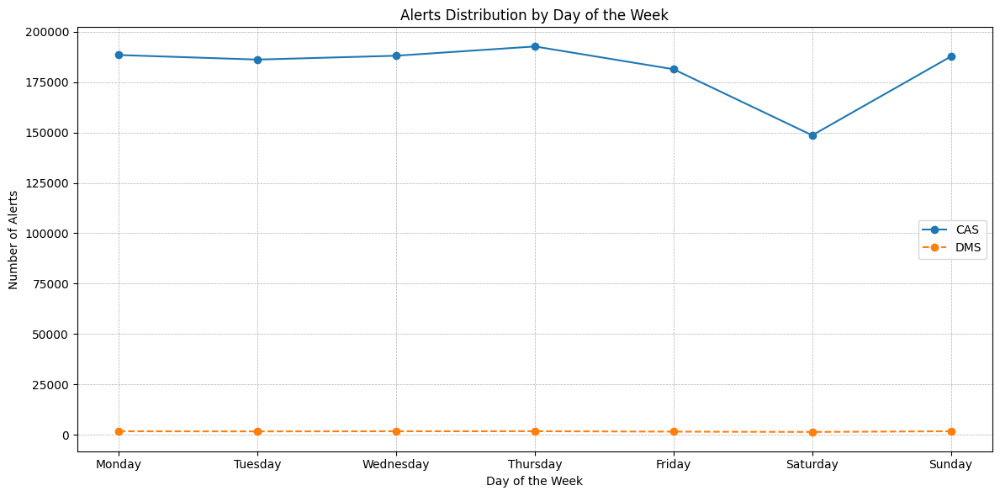

In [ ]:
import matplotlib.pyplot as plt

days_of_week = ['Monday', 'Tuesday', 'Wednesday', 'Thursday', 'Friday', 'Saturday', 'Sunday']

plt.figure(figsize=(12,6))

plt.plot(days_of_week, cas_weekday.values, label="CAS", marker='o')
plt.plot(days_of_week, dms_weekday.values, label="DMS", linestyle='--', marker='o')

plt.xlabel('Day of the Week')
plt.ylabel('Number of Alerts')
plt.title('Alerts Distribution by Day of the Week')
plt.legend()
plt.grid(True, which='both', linestyle='--', linewidth=0.5)
plt.tight_layout()

plt.show()


This output provides some interesting insights into the distribution of alerts by the day of the week for both CAS and DMS datasets. Here's an analysis based on the provided data:

Analysis:
Volume: CAS alerts are considerably more numerous than DMS alerts across all days. This indicates that the CAS system triggers a much higher number of alerts compared to the DMS system.

Peak Days:

CAS: Monday (0) and Sunday (6) have the highest number of alerts. This could indicate heightened vehicular activities or riskier driving behaviors during the start and end of the week.
DMS: Sunday (6) has the highest number of alerts, followed by Monday (0). The pattern is somewhat similar to the CAS system, although the absolute numbers are much lower.
Mid-Week Decline: Both CAS and DMS show a dip in the number of alerts around Wednesday (3) and Thursday (4). This could indicate safer driving behaviors, lesser vehicular activity, or the effectiveness of some interventions during the mid-week.

Weekend: There's an uptick in CAS alerts on Saturday (5), potentially indicating increased weekend vehicular activity. DMS alerts show a slight increase but not as pronounced as CAS.


This visualization will help stakeholders quickly comprehend the variation in alerts across the days of the week.

Potential Scalability:
The approach to analyze alerts by the day of the week is highly scalable. This methodology can be applied to any time-stamped dataset across various domains to understand weekly patterns. It's especially valuable for industries that want to gauge activities, behaviors, or events by different days of the week.





